John Singer Sargent: Realism  
Edgar Degas: Impressionism  
Giovanni Battista Piranesi: Neoclassicism  
Claude Monet: Impressionism  
Raphael Kirchner: Art Noveau  
Salvador Dali: Surrealism  

In [1]:
import pandas as pd
import numpy as np
import sys
import re
import os
import matplotlib.pyplot as plt
%matplotlib inline

from PIL import Image, ImageChops, ImageOps

from keras.models import Sequential
from keras.layers import Dense, Input, Dropout, Conv2D, MaxPool2D, Flatten
from keras.utils import to_categorical
from keras.wrappers.scikit_learn import KerasClassifier

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler



Using TensorFlow backend.


In [2]:
train_info = pd.read_csv('train_info.csv')
all_data_info = pd.read_csv('all_data_info.csv')

In [3]:
df = all_data_info.loc[all_data_info['artist'].isin(['John Singer Sargent', 'Edgar Degas', 'Giovanni Battista Piranesi', 'Claude Monet', 'Raphael Kirchner','Salvador Dali'])]

In [4]:
train = df[df['in_train']== True]
final_test = df[df['in_train']== False]

In [5]:
selected_jpgs = list(train.new_filename.values)

In [6]:
originals = "/Users/jenelleverrochi/Desktop/Capstone/train/"
rgb_images = "/Users/jenelleverrochi/Desktop/Capstone/6_artists/rgb_images/"
thumbs64 = "/Users/jenelleverrochi/Desktop/Capstone/6_artists/thumbs64/"
thumbs128 = "/Users/jenelleverrochi/Desktop/Capstone/6_artists/thumbs128/"

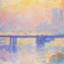

In [7]:
Image.open(thumbs64+'804.jpg')

In [8]:
def get_array(jpg):
    pic = Image.open(thumbs64+jpg)
    array = np.array(pic.getdata()).reshape(pic.size[0], pic.size[1],3)
    return array

In [9]:
train_array = []
for i in selected_jpgs:
    train_array.append(get_array(i))

In [10]:
print(len(train_array))
print(len(train_array[0]))
print(len(train_array[0][0]))
print(len(train_array[0][0][0]))

2254
64
64
3


In [11]:
train_array_2d = np.reshape(train_array, (2254,12288))

In [12]:
train_df = pd.DataFrame(train_array_2d)

In [13]:
selected_jpgs_df = pd.DataFrame(selected_jpgs, columns=['jpg'])
selected_jpgs_df.tail()

,jpg
2249,95451.jpg
2250,38925.jpg
2251,39044.jpg
2252,65191.jpg
2253,46569.jpg


In [14]:
train_df = pd.concat([train_df, selected_jpgs_df], axis=1)
train_df.head()

,0,1,2,3,4,5,6,7,8,9,...,12279,12280,12281,12282,12283,12284,12285,12286,12287,jpg
0,99,81,67,97,79,65,95,77,63,96,...,65,61,52,64,60,51,63,59,50,95360.jpg
1,171,171,143,176,176,148,173,176,147,167,...,105,126,119,112,132,123,121,141,132,49757.jpg
2,227,227,227,234,234,234,238,238,238,239,...,235,235,235,220,220,220,222,222,222,96147.jpg
3,232,232,232,232,232,232,232,232,232,231,...,235,235,235,236,236,236,239,239,239,11889.jpg
4,107,107,107,116,116,116,105,105,105,119,...,104,104,104,131,131,131,182,182,182,856.jpg


In [15]:
artist_df = all_data_info[['new_filename', 'artist']]
artist_df.columns = ['jpg', 'artist']

In [16]:
train_df = pd.merge(train_df, artist_df, on='jpg', how='left')
train_df.head()

,0,1,2,3,4,5,6,7,8,9,...,12280,12281,12282,12283,12284,12285,12286,12287,jpg,artist
0,99,81,67,97,79,65,95,77,63,96,...,61,52,64,60,51,63,59,50,95360.jpg,Edgar Degas
1,171,171,143,176,176,148,173,176,147,167,...,126,119,112,132,123,121,141,132,49757.jpg,Claude Monet
2,227,227,227,234,234,234,238,238,238,239,...,235,235,220,220,220,222,222,222,96147.jpg,Giovanni Battista Piranesi
3,232,232,232,232,232,232,232,232,232,231,...,235,235,236,236,236,239,239,239,11889.jpg,Giovanni Battista Piranesi
4,107,107,107,116,116,116,105,105,105,119,...,104,104,131,131,131,182,182,182,856.jpg,Giovanni Battista Piranesi


In [17]:
X = train_df.iloc[:,:-2]
y = train_df.iloc[:,-1]

In [18]:
y = pd.get_dummies(y)

In [19]:
X_train, X_test, y_train, y_test = train_test_split(X, y)

In [20]:
X_train = X_train/255.
X_test = X_test/255.

In [21]:
X_train = np.array(X_train)
X_test = np.array(X_test)

y_train = np.array(y_train)
y_test = np.array(y_test)

print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(1690, 12288)
(564, 12288)
(1690, 6)
(564, 6)


In [22]:
import seaborn as sns
import matplotlib.image as mpimg

In [23]:
mean = train_df.groupby('artist').mean()

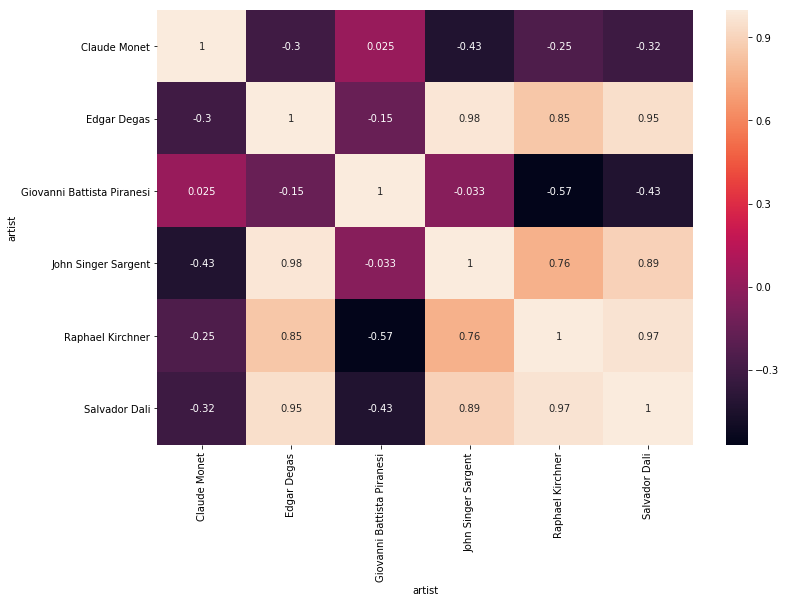

In [25]:
plt.figure(figsize=(12,8))
sns.heatmap((mean.iloc[:,:11].T).corr(), annot=True)

In [24]:
def process(filename):
    image = mpimg.imread(filename)

    plt.figure()
    plt.imshow(image)
    plt.yticks([])
    plt.xticks([])

In [25]:
train_jss = train[train['artist']== 'John Singer Sargent']
train_ed = train[train['artist'] == 'Edgar Degas']
train_cm = train[train['artist'] == 'Claude Monet']
train_gbp = train[train['artist'] == 'Giovanni Battista Piranesi']
train_sd = train[train['artist'] == 'Salvador Dali']
train_rk = train[train['artist'] == 'Raphael Kirchner']

In [31]:
jss_jpgs = list(train_jss.new_filename)[:50]
ed_jpgs = list(train_ed.new_filename)[:50]
cm_jpgs = list(train_cm.new_filename)[:50]
gbp_jpgs = list(train_gbp.new_filename)[:50]
sd_jpgs = list(train_sd.new_filename)[:50]
rk_jpgs = list(train_rk.new_filename)[:50]


/Users/jenelleverrochi/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


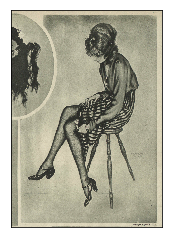

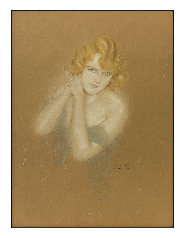

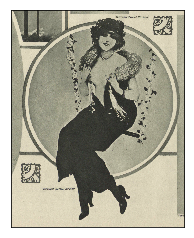

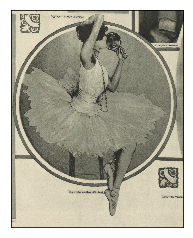

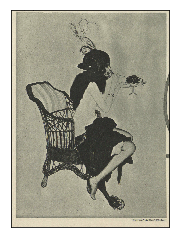

...

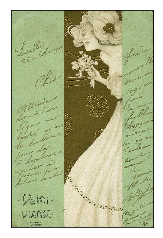

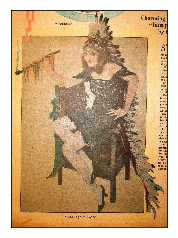

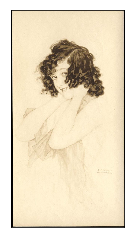

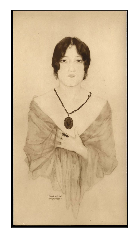

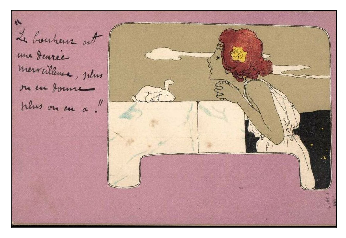

In [32]:
for i in rk_jpgs:    
    process(originals + i)

/Users/jenelleverrochi/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


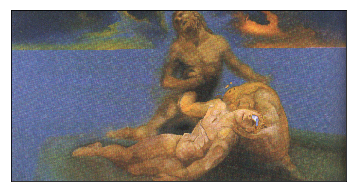

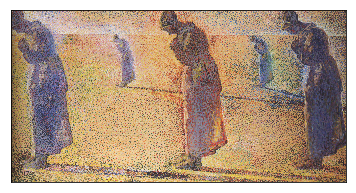

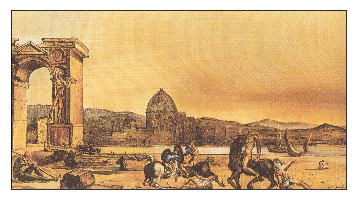

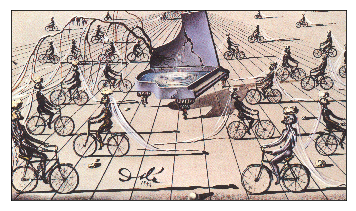

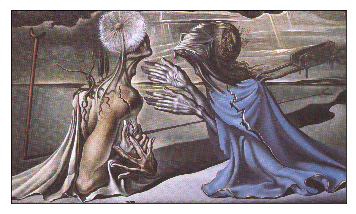

...

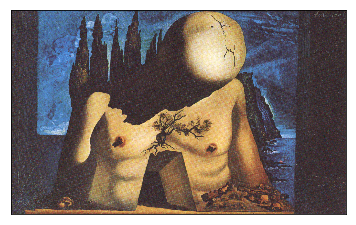

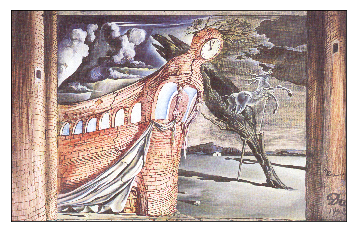

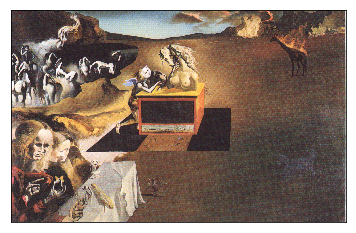

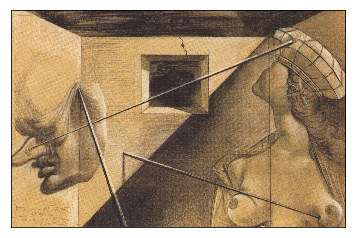

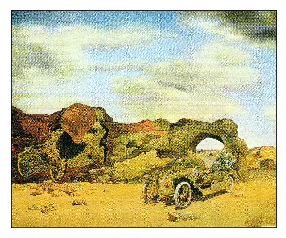

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


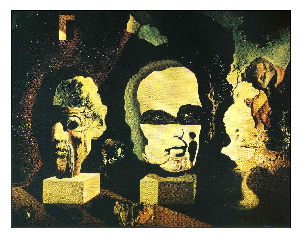

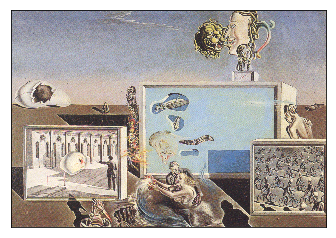

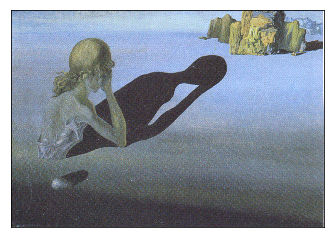

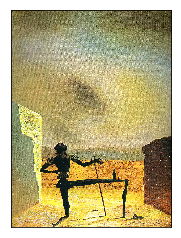

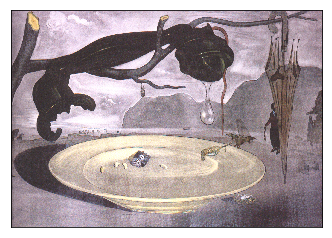

...

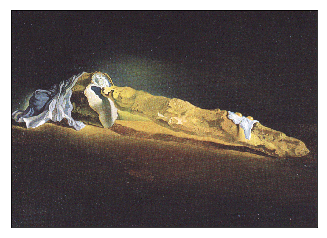

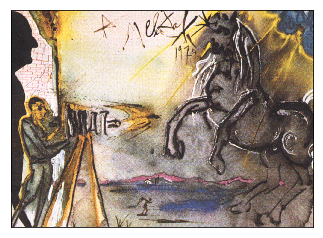

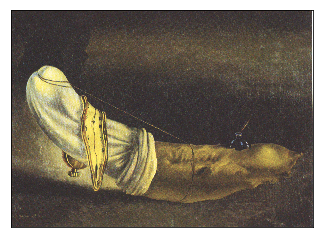

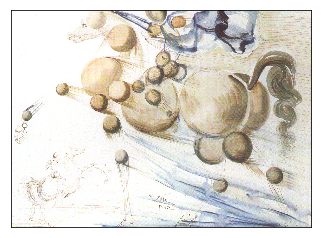

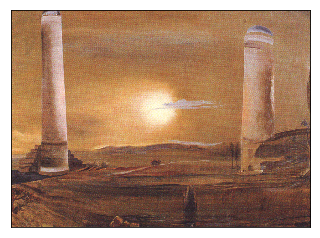

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


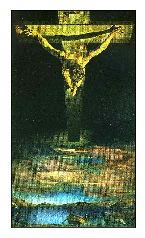

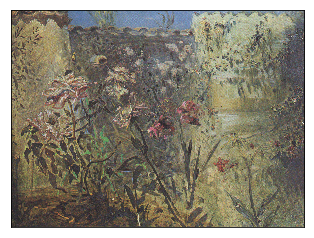

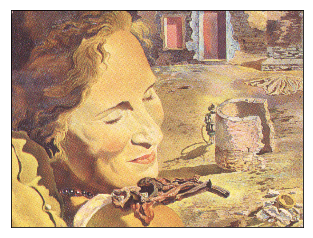

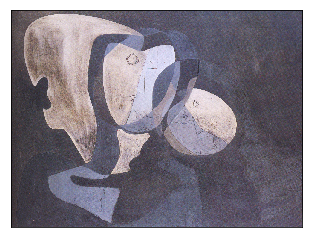

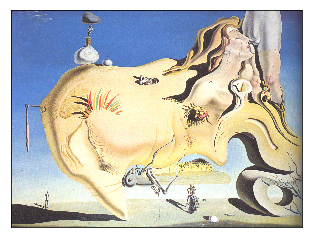

...

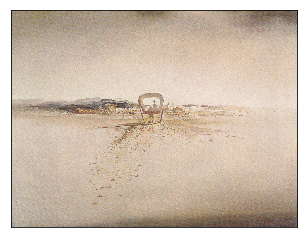

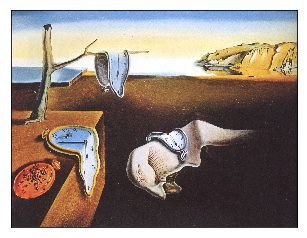

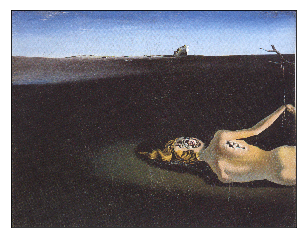

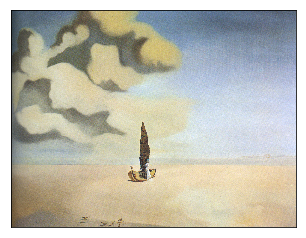

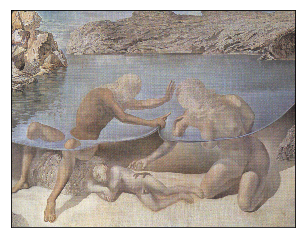

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [33]:
for i in sd_jpgs:    
    process(originals + i)

/Users/jenelleverrochi/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


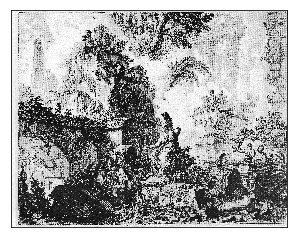

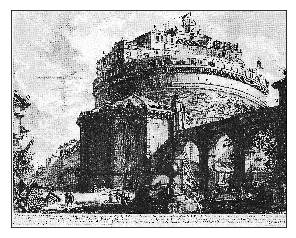

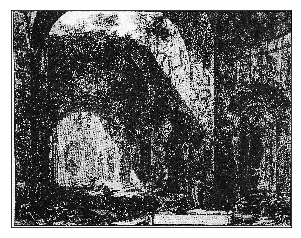

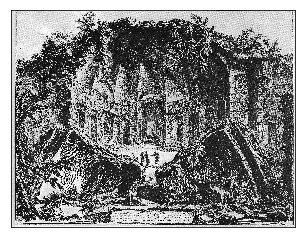

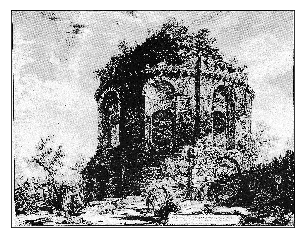

...

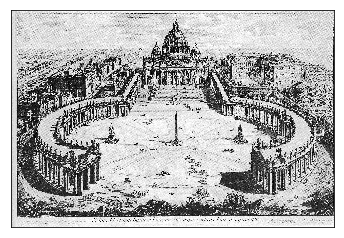

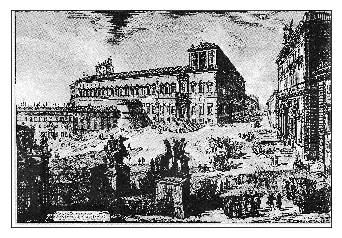

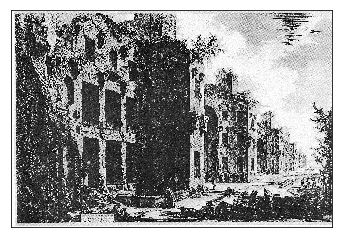

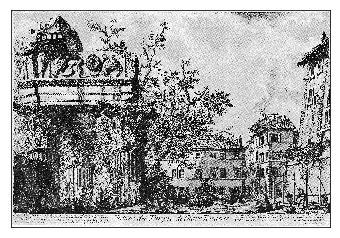

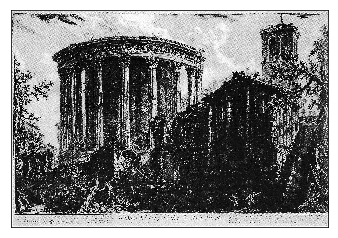

In [34]:
for i in gbp_jpgs:    
    process(originals + i)

/Users/jenelleverrochi/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


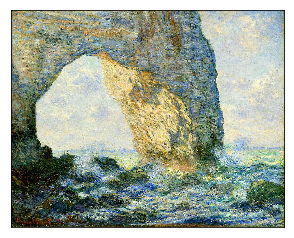

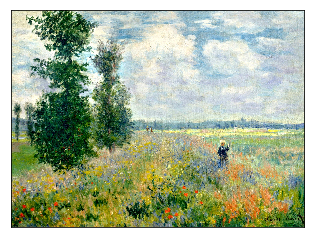

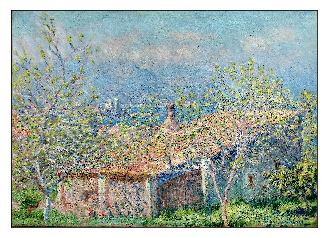

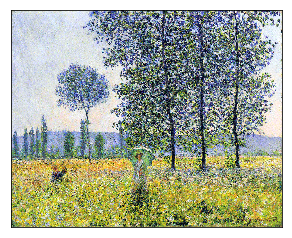

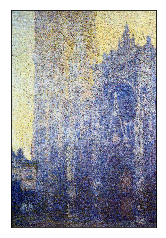

...

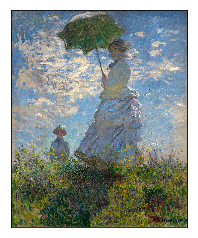

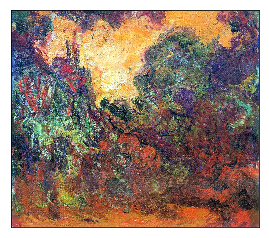

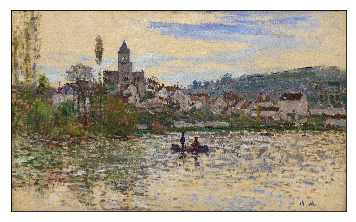

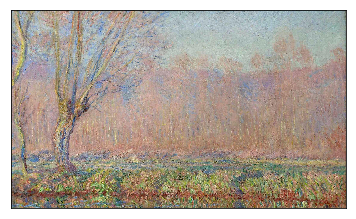

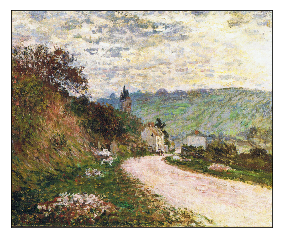

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


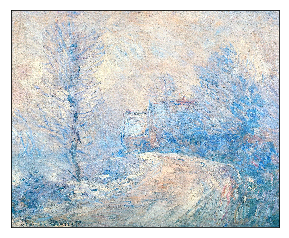

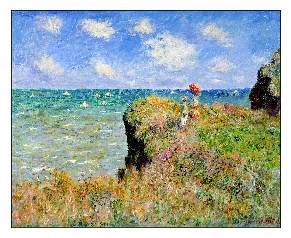

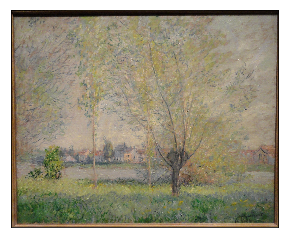

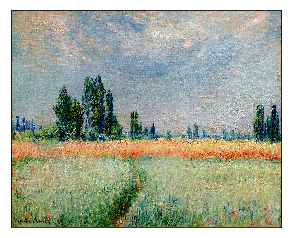

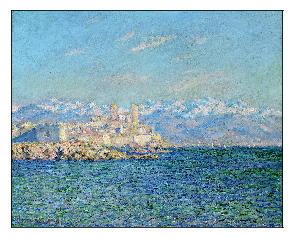

...

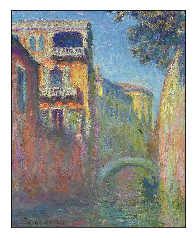

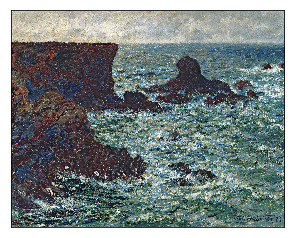

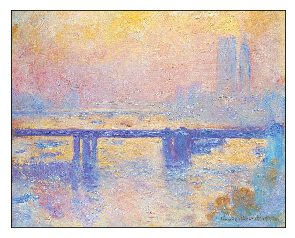

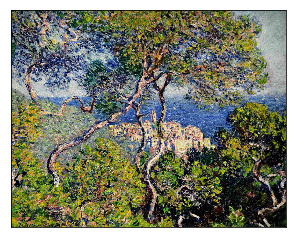

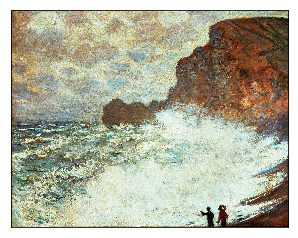

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [35]:
for i in cm_jpgs:    
    process(originals + i)

/Users/jenelleverrochi/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


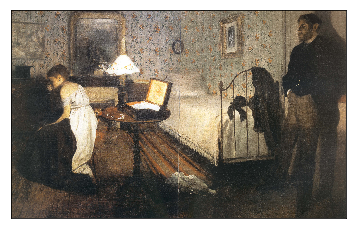

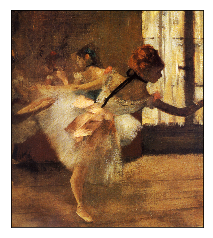

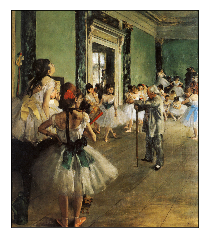

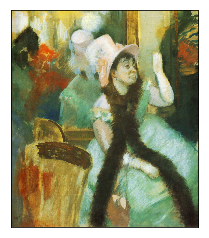

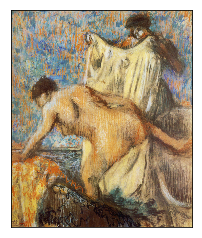

...

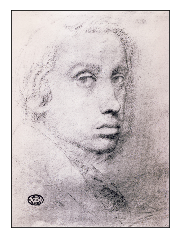

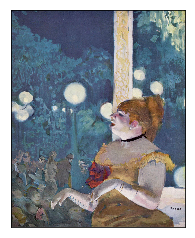

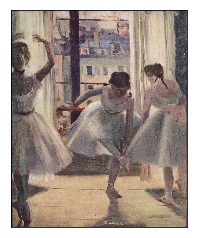

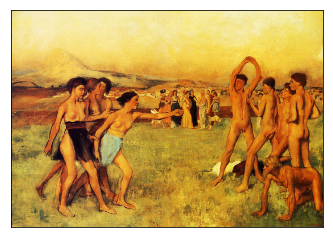

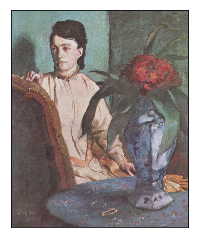

In [38]:
for i in ed_jpgs:    
    process(originals + i)

/Users/jenelleverrochi/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


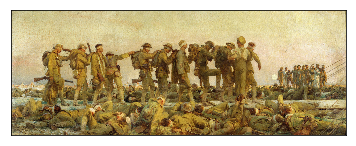

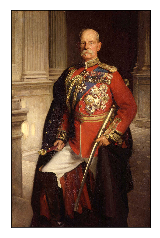

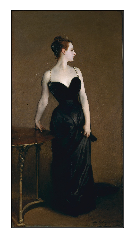

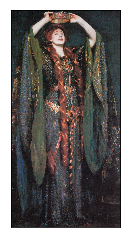

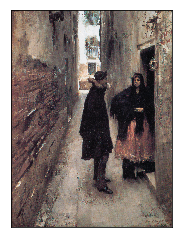

...

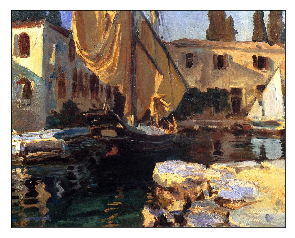

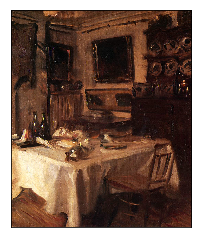

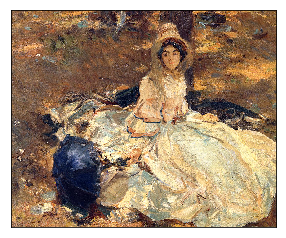

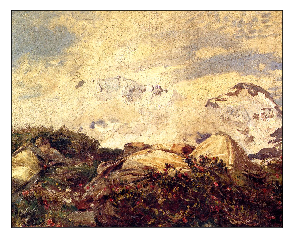

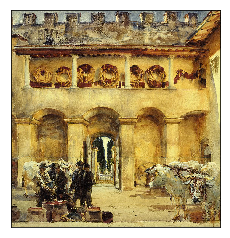

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


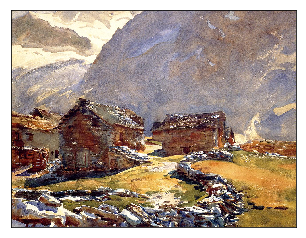

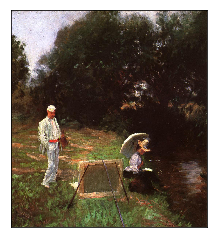

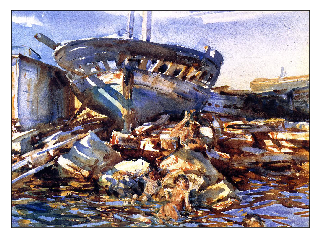

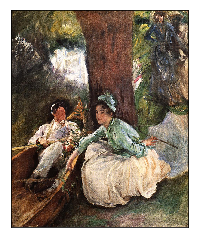

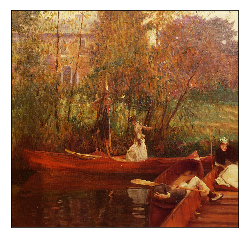

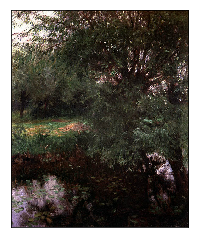

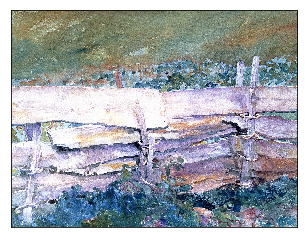

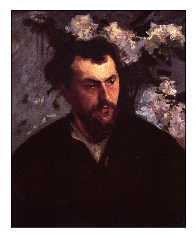

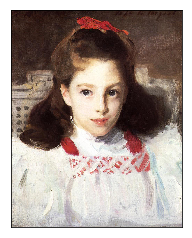

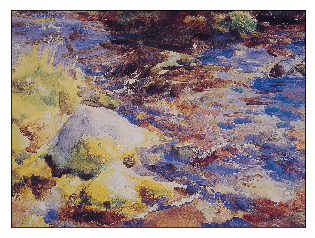

In [37]:
for i in jss_jpgs:    
    process(originals + i)

In [37]:
hist_df = df[['artist', 'style']]
hist_df = hist_df.groupby('artist').count()
hist_df

,style
artist,
Claude Monet,498
Edgar Degas,495
Giovanni Battista Piranesi,500
John Singer Sargent,500
Raphael Kirchner,497
Salvador Dali,485


In [38]:
artists = hist_df.index
paintings = list(hist_df['style'])
print(artists, paintings)

Index(['Claude Monet', 'Edgar Degas', 'Giovanni Battista Piranesi',
       'John Singer Sargent', 'Raphael Kirchner', 'Salvador Dali'],
      dtype='object', name='artist') [498, 495, 500, 500, 497, 485]


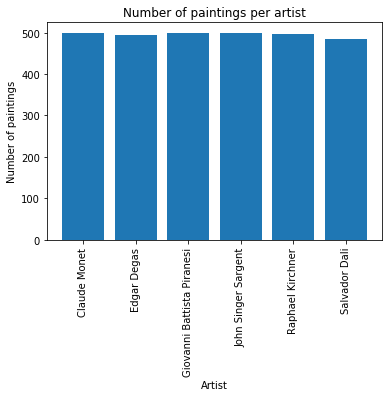

In [39]:
ax = plt.subplot()
ax.bar(range(len(paintings)), paintings)
plt.xticks(range(len(paintings)), rotation= 90)
ax.set_xticklabels(artists)
ax.set_title('Number of paintings per artist')
ax.set_xlabel('Artist')
ax.set_ylabel('Number of paintings')
plt.show()